In [1]:
import os
import zipfile
import numpy as np
import seaborn as sns
import pandas as pd
import torch
import requests
import json
import matplotlib.pyplot as plt
import random
import cv2
from torch.utils.data import Dataset, DataLoader
from pycocotools.coco import COCO
from PIL import Image
from tqdm import tqdm
from tabulate import tabulate
import torchvision.transforms as T
from pycocotools.coco import COCO
from pycocotools.cocoeval import COCOeval
from PIL import Image


%matplotlib inline

In [2]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

Using device: cuda


In [3]:
# url = "https://public.roboflow.com/ds/uB5QQ7c9b6?key=tpqNjLKhtg"
# zip_path = "fire_dataset.zip"

# # Download
# response = requests.get(url)
# with open(zip_path, "wb") as f:
#     f.write(response.content)

# # Unzip
# with zipfile.ZipFile(zip_path, 'r') as zip_ref:
#     zip_ref.extractall("fire_dataset")

# print("✅ Dataset downloaded and extracted!")

In [4]:
train_annotation="/kaggle/working/fire_dataset/train/_annotations.coco.json"
train_image="/kaggle/working/fire_dataset/train/"

valid_annotation="/kaggle/working/fire_dataset/valid/_annotations.coco.json"
valid_image="/kaggle/working/fire_dataset/valid/"


test_annotation="/kaggle/working/fire_dataset/test/_annotations.coco.json"
test_image="/kaggle/working/fire_dataset/test/"

In [5]:
def inspect_coco_json(ann_file):
    if not os.path.exists(ann_file):
        print(f"❌ Annotation file not found: {ann_file}")
        return
    with open(ann_file, 'r') as f:
        coco_data = json.load(f)
    
    print(f"\nInspecting {ann_file}:")
    print(f"Number of images: {len(coco_data['images'])}")
    print(f"Number of annotations: {len(coco_data['annotations'])}")
    print(f"Categories: {[cat['name'] for cat in coco_data['categories']]}")
    
    # Check for segmentation masks
    has_segmentation = any('segmentation' in ann and ann['segmentation'] for ann in coco_data['annotations'])
    print(f"Segmentation masks present: {has_segmentation}")

# Inspect all annotation files
inspect_coco_json("/kaggle/working/fire_dataset/train/_annotations.coco.json")
inspect_coco_json("/kaggle/working/fire_dataset/valid/_annotations.coco.json")
inspect_coco_json("/kaggle/working/fire_dataset/test/_annotations.coco.json")


Inspecting /kaggle/working/fire_dataset/train/_annotations.coco.json:
Number of images: 516
Number of annotations: 516
Categories: ['smoke']
Segmentation masks present: False

Inspecting /kaggle/working/fire_dataset/valid/_annotations.coco.json:
Number of images: 147
Number of annotations: 147
Categories: ['smoke']
Segmentation masks present: False

Inspecting /kaggle/working/fire_dataset/test/_annotations.coco.json:
Number of images: 74
Number of annotations: 74
Categories: ['smoke']
Segmentation masks present: False


In [6]:
import json
import os

def fix_categories(ann_file):
    with open(ann_file, 'r') as f:
        coco_data = json.load(f)
    
    # Merge 'Smoke' and 'smoke' into 'smoke'
    new_categories = [{"id": 1, "name": "smoke", "supercategory": "object"}]
    category_map = {cat["id"]: 1 for cat in coco_data["categories"]}  # Map old IDs to new ID
    
    # Update annotations
    for ann in coco_data["annotations"]:
        ann["category_id"] = category_map[ann["category_id"]]
    
    # Update categories
    coco_data["categories"] = new_categories
    
    # Save updated JSON
    with open(ann_file, 'w') as f:
        json.dump(coco_data, f, indent=2)
    print(f"✅ Fixed categories in {ann_file}")

# Fix all annotation files
ann_files = [
    "/kaggle/working/fire_dataset/train/_annotations.coco.json",
    "/kaggle/working/fire_dataset/valid/_annotations.coco.json",
    "/kaggle/working/fire_dataset/test/_annotations.coco.json"
]

for ann_file in ann_files:
    if os.path.exists(ann_file):
        fix_categories(ann_file)
    else:
        print(f"❌ File not found: {ann_file}")

✅ Fixed categories in /kaggle/working/fire_dataset/train/_annotations.coco.json
✅ Fixed categories in /kaggle/working/fire_dataset/valid/_annotations.coco.json
✅ Fixed categories in /kaggle/working/fire_dataset/test/_annotations.coco.json


In [7]:
inspect_coco_json("/kaggle/working/fire_dataset/train/_annotations.coco.json")
inspect_coco_json("/kaggle/working/fire_dataset/valid/_annotations.coco.json")
inspect_coco_json("/kaggle/working/fire_dataset/test/_annotations.coco.json")


Inspecting /kaggle/working/fire_dataset/train/_annotations.coco.json:
Number of images: 516
Number of annotations: 516
Categories: ['smoke']
Segmentation masks present: False

Inspecting /kaggle/working/fire_dataset/valid/_annotations.coco.json:
Number of images: 147
Number of annotations: 147
Categories: ['smoke']
Segmentation masks present: False

Inspecting /kaggle/working/fire_dataset/test/_annotations.coco.json:
Number of images: 74
Number of annotations: 74
Categories: ['smoke']
Segmentation masks present: False


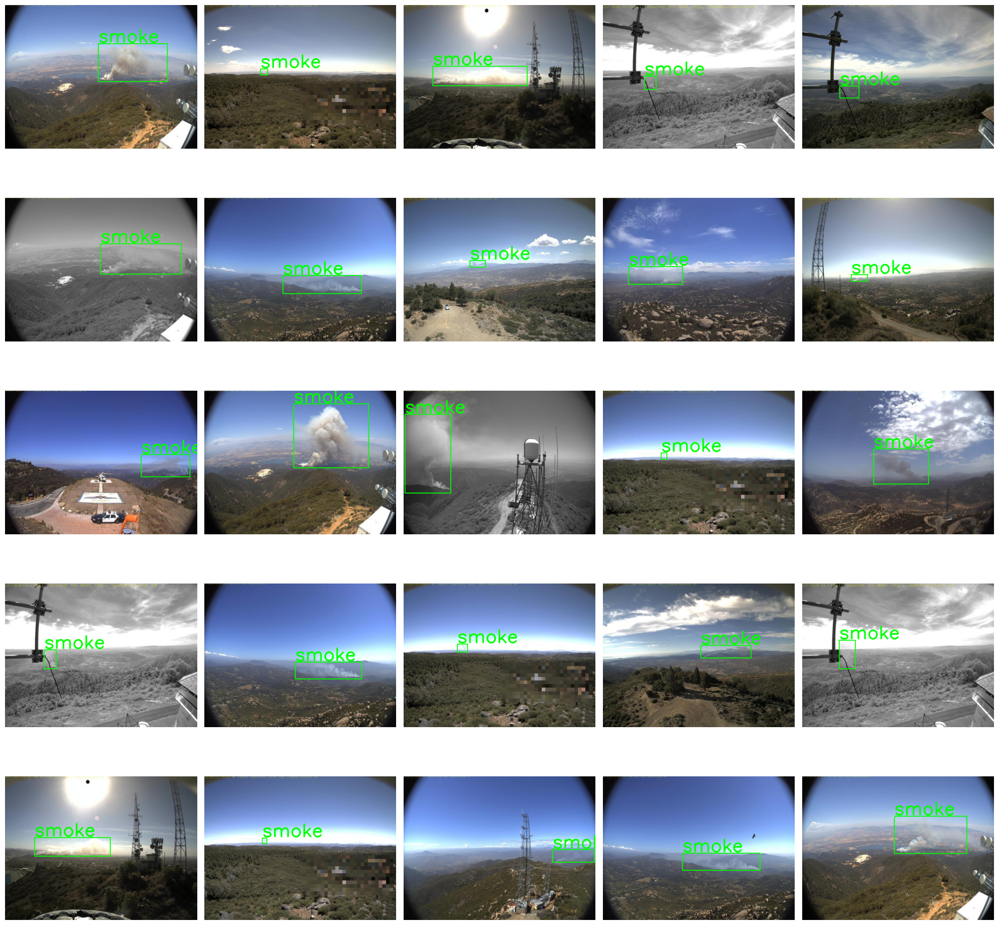

In [8]:
with open(train_annotation, "r") as f:
    coco_data = json.load(f)

images = {img["id"]: img for img in coco_data["images"]}
annotations = coco_data["annotations"]
categories = {cat["id"]: cat["name"] for cat in coco_data["categories"]}

ann_by_image = {}
for ann in annotations:
    img_id = ann["image_id"]
    ann_by_image.setdefault(img_id, []).append(ann)

sample_imgs = random.sample(list(images.keys()), 25)

fig, axes = plt.subplots(5, 5, figsize=(20, 20))
axes = axes.flatten()

for ax, img_id in zip(axes, sample_imgs):
    img_info = images[img_id]
    img_path = os.path.join(train_image, img_info["file_name"])
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    if img_id in ann_by_image:
        for ann in ann_by_image[img_id]:
            x, y, w, h = ann["bbox"]
            category = categories[ann["category_id"]]
            cv2.rectangle(img, (int(x), int(y)), (int(x+w), int(y+h)), (0, 255, 0), 2)
            cv2.putText(img, category, (int(x), int(y-5)), cv2.FONT_HERSHEY_SIMPLEX, 2, (0, 255, 0), 3, cv2.LINE_AA)

    ax.imshow(img)
    ax.axis("off")

plt.tight_layout()
plt.show()

In [9]:
class FireDataset(Dataset):
    def __init__(self, image_dir, ann_file, transform=None):
        self.image_dir = image_dir
        self.coco = COCO(ann_file)
        self.image_ids = list(self.coco.imgs.keys())
        self.transform = transform

    def __len__(self):
        return len(self.image_ids)

    def __getitem__(self, idx):
        img_id = self.image_ids[idx]
        img_info = self.coco.loadImgs(img_id)[0]
        img_path = os.path.join(self.image_dir, img_info['file_name'])
        
        try:
            img = Image.open(img_path).convert("RGB")
        except FileNotFoundError:
            print(f"Warning: Image not found at {img_path} (image_id: {img_id})")
            return None, None

        # Load annotations
        ann_ids = self.coco.getAnnIds(imgIds=img_id)
        anns = self.coco.loadAnns(ann_ids)

        boxes = []
        labels = []
        masks = []

        height, width = img_info['height'], img_info['width']
        for ann in anns:
            if ann.get('iscrowd', 0) == 0:
                x, y, w, h = ann['bbox']
                boxes.append([x, y, x + w, y + h])
                labels.append(ann['category_id'])
                # Create empty mask since segmentation is missing
                mask = torch.zeros((height, width), dtype=torch.uint8)
                masks.append(mask)

        # Handle empty annotations
        if not boxes:
            boxes = torch.zeros((0, 4), dtype=torch.float32)
            labels = torch.zeros((0,), dtype=torch.int64)
            masks = torch.zeros((0, height, width), dtype=torch.uint8)
        else:
            boxes = torch.as_tensor(boxes, dtype=torch.float32)
            labels = torch.as_tensor(labels, dtype=torch.int64)
            masks = torch.stack(masks, dim=0)  # Stack masks to ensure consistent shape

        target = {
            "boxes": boxes,
            "labels": labels,
            "masks": masks,
            "image_id": torch.tensor([img_id], dtype=torch.int64),
            "area": torch.tensor([ann['area'] for ann in anns], dtype=torch.float32) if anns else torch.zeros((0,), dtype=torch.float32),
            "iscrowd": torch.zeros(len(anns), dtype=torch.uint8) if anns else torch.zeros((0,), dtype=torch.uint8)
        }

        if self.transform:
            img = self.transform(img)

        return img, target


transform = T.ToTensor()
train_dataset = FireDataset(train_image, train_annotation, transform=transform)
valid_dataset = FireDataset(valid_image, valid_annotation, transform=transform)
test_dataset = FireDataset(test_image, test_annotation, transform=transform)

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


In [10]:
def collate_fn(batch):
    batch = [b for b in batch if b[0] is not None]  
    return tuple(zip(*batch)) if batch else ([], [])

train_loader = DataLoader(train_dataset, batch_size=2, shuffle=True, num_workers=2, 
                          collate_fn=collate_fn)
valid_loader = DataLoader(valid_dataset, batch_size=2, shuffle=False, num_workers=2, 
                          collate_fn=collate_fn)
test_loader = DataLoader(test_dataset, batch_size=2, shuffle=False, num_workers=2, 
                         collate_fn=collate_fn)

In [11]:
for images, targets in train_loader:
    print(f"Batch size: {len(images)}")
    for i, img in enumerate(images):
        print(f" Image {i} shape: {img.shape}")
        print(f" Target {i} keys: {targets[i].keys()}")
        print(f"  Boxes shape: {targets[i]['boxes'].shape}")
        print(f"  Labels shape: {targets[i]['labels'].shape}")
    break  


Batch size: 2
 Image 0 shape: torch.Size([3, 480, 640])
 Target 0 keys: dict_keys(['boxes', 'labels', 'masks', 'image_id', 'area', 'iscrowd'])
  Boxes shape: torch.Size([1, 4])
  Labels shape: torch.Size([1])
 Image 1 shape: torch.Size([3, 480, 640])
 Target 1 keys: dict_keys(['boxes', 'labels', 'masks', 'image_id', 'area', 'iscrowd'])
  Boxes shape: torch.Size([1, 4])
  Labels shape: torch.Size([1])


In [12]:
from torchvision.models.detection import maskrcnn_resnet50_fpn
import torch.optim as optim
from tqdm import tqdm
from tabulate import tabulate
import torchvision

model = maskrcnn_resnet50_fpn(pretrained=True)
num_classes = 2  # 1 class (smoke) + background
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = torchvision.models.detection.faster_rcnn.FastRCNNPredictor(in_features, num_classes)
in_features_mask = model.roi_heads.mask_predictor.conv5_mask.in_channels
model.roi_heads.mask_predictor = torchvision.models.detection.mask_rcnn.MaskRCNNPredictor(in_features_mask, 256, num_classes)
model.to(device)

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=MaskRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=MaskRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


MaskRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(in

In [13]:
params = [p for p in model.parameters() if p.requires_grad]
optimizer = optim.SGD(params, lr=0.005, momentum=0.9, weight_decay=0.0005)

In [14]:
from pycocotools.coco import COCO
from pycocotools.cocoeval import COCOeval
from tqdm import tqdm
import torch
from tabulate import tabulate

num_epochs = 10
train_losses = []
valid_metrics = []

confidence_threshold = 0.5

for epoch in range(num_epochs):
    model.train()
    epoch_loss = {'loss_classifier': 0.0, 'loss_box_reg': 0.0, 'loss_mask': 0.0,
                  'loss_objectness': 0.0, 'loss_rpn_box_reg': 0.0, 'total_loss': 0.0}
    train_progress = tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs} [Train]", leave=False)
    
    for images, targets in train_progress:
        images = [img.to(device) for img in images]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())
        for key in epoch_loss:
            if key in loss_dict:
                epoch_loss[key] += loss_dict[key].item()
            elif key == 'total_loss':
                epoch_loss[key] += losses.item()
        optimizer.zero_grad()
        losses.backward()
        optimizer.step()
        train_progress.set_postfix({k: f"{v/train_progress.total:.4f}" for k, v in epoch_loss.items()})

    epoch_loss = {k: v / len(train_loader) for k, v in epoch_loss.items()}
    train_losses.append(epoch_loss)

    model.eval()
    coco_predictions = []

    with torch.no_grad():
        for images, targets in tqdm(valid_loader, desc=f"Epoch {epoch+1}/{num_epochs} [Valid]", leave=False):
            images = [img.to(device) for img in images]
            outputs = model(images)
            for output, target in zip(outputs, targets):
                image_id = target['image_id'].item()
                for box, score, label in zip(output['boxes'], output['scores'], output['labels']):
                    if score > confidence_threshold:
                        x_min, y_min, x_max, y_max = box.cpu().numpy()
                        coco_predictions.append({"image_id": image_id, "category_id": label.item(),
                                                 "bbox": [x_min, y_min, x_max - x_min, y_max - y_min],
                                                 "score": score.item()})

    coco = COCO(valid_annotation)
    coco_dt = coco.loadRes(coco_predictions)
    coco_eval = COCOeval(coco, coco_dt, "bbox")
    coco_eval.evaluate()
    coco_eval.accumulate()
    coco_eval.summarize()

    metrics = {'mAP': coco_eval.stats[0], 'AP@0.5': coco_eval.stats[1], 'AP@0.75': coco_eval.stats[2],
               'AP_small': coco_eval.stats[3], 'AP_medium': coco_eval.stats[4], 'AP_large': coco_eval.stats[5],
               'AR@1': coco_eval.stats[6], 'AR@10': coco_eval.stats[7], 'AR@100': coco_eval.stats[8],
               'AR_small': coco_eval.stats[9], 'AR_medium': coco_eval.stats[10], 'AR_large': coco_eval.stats[11]}
    valid_metrics.append(metrics)

    table_data = [['Train Loss', epoch_loss['loss_classifier'], epoch_loss['loss_box_reg'],
                   epoch_loss['loss_mask'], epoch_loss['loss_objectness'],
                   epoch_loss['loss_rpn_box_reg'], epoch_loss['total_loss']],
                  ['Valid Metrics', metrics['mAP'], metrics['AP@0.5'], metrics['AP@0.75'], '-', '-', '-']]
    headers = ['Phase', 'Classifier/mAP', 'Box/AP@0.5', 'Mask/AP@0.75', 'Objectness', 'RPN Box Reg', 'Total']
    print(f"\nEpoch {epoch+1}/{num_epochs} Summary:")
    print(tabulate(table_data, headers=headers, tablefmt='grid', floatfmt='.4f'))

torch.save(model.state_dict(), "/kaggle/working/maskrcnn_fire.pth")
print("✅ Model saved to /kaggle/working/maskrcnn_fire.pth")


loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.05s).
Accumulating evaluation results...
DONE (t=0.01s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.743
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.204
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.285
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.382
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.367
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.432
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.04s).
Accumulating evaluation results...
DONE (t=0.01s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.395
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.881
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.255
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.283
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.398
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.460
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.452
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.474
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.04s).
Accumulating evaluation results...
DONE (t=0.01s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.402
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.361
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.288
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.402
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.502
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.476
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.493
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.04s).
Accumulating evaluation results...
DONE (t=0.01s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.443
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.890
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.425
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.314
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.435
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.523
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.501
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.515
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.04s).
Accumulating evaluation results...
DONE (t=0.01s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.431
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.866
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.369
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.409
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.537
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.502
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.512
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.04s).
Accumulating evaluation results...
DONE (t=0.01s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.928
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.461
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.284
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.568
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.523
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.533
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.04s).
Accumulating evaluation results...
DONE (t=0.01s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.449
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.907
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.338
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.311
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.436
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.548
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.515
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.518
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.04s).
Accumulating evaluation results...
DONE (t=0.01s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.458
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.884
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.430
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.439
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.566
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.522
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.526
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.26s).
Accumulating evaluation results...
DONE (t=0.01s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.450
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.850
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.435
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.288
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.429
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.581
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.512
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.522
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.04s).
Accumulating evaluation results...
DONE (t=0.01s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.463
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.880
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.433
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.308
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.461
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.551
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.510
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.528
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets

In [15]:
model.load_state_dict(torch.load("/kaggle/working/maskrcnn_fire.pth"))
model.to(device)
model.eval()


MaskRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(in

In [16]:
predictions = []
test_progress = tqdm(test_loader, desc="Predicting on Test Set")
with torch.no_grad():
    for images, targets in test_progress:
        if not images:
            continue
        images = [img.to(device) for img in images]
        preds = model(images)
        for pred, target in zip(preds, targets):
            image_id = target['image_id'].item()
            for box, score, label in zip(pred['boxes'], pred['scores'], pred['labels']):
                if score > 0.5:  # Confidence threshold
                    x_min, y_min, x_max, y_max = box.cpu().numpy()
                    predictions.append({
                        "image_id": image_id,
                        "category_id": label.item(),
                        "bbox": [x_min, y_min, x_max - x_min, y_max - y_min],
                        "score": score.item()
                    })

# Compute COCO metrics
coco = COCO("/kaggle/working/fire_dataset/test/_annotations.coco.json")
coco_dt = coco.loadRes(predictions)
coco_eval = COCOeval(coco, coco_dt, "bbox")
coco_eval.evaluate()
coco_eval.accumulate()
coco_eval.summarize()

# Format metrics in a table
metrics = {
    'mAP': coco_eval.stats[0],  # AP@0.5:0.95
    'AP@0.5': coco_eval.stats[1],
    'AP@0.75': coco_eval.stats[2],
    'AP_small': coco_eval.stats[3],
    'AP_medium': coco_eval.stats[4],
    'AP_large': coco_eval.stats[5],
    'AR@1': coco_eval.stats[6],
    'AR@10': coco_eval.stats[7],
    'AR@100': coco_eval.stats[8],
    'AR_small': coco_eval.stats[9],
    'AR_medium': coco_eval.stats[10],
    'AR_large': coco_eval.stats[11]
}

table_data = [[
    metrics['mAP'], metrics['AP@0.5'], metrics['AP@0.75'],
    metrics['AP_small'], metrics['AP_medium'], metrics['AP_large'],
    metrics['AR@1'], metrics['AR@10'], metrics['AR@100'],
    metrics['AR_small'], metrics['AR_medium'], metrics['AR_large']
]]
headers = [
    'mAP', 'AP@0.5', 'AP@0.75', 'AP_small', 'AP_medium', 'AP_large',
    'AR@1', 'AR@10', 'AR@100', 'AR_small', 'AR_medium', 'AR_large'
]
print("\nTest Set COCO Metrics:")
print(tabulate(table_data, headers=headers, tablefmt='grid', floatfmt='.4f'))



Predicting on Test Set: 100%|██████████| 37/37 [00:05<00:00,  7.29it/s]


loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.02s).
Accumulating evaluation results...
DONE (t=0.01s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.500
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.856
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.550
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.374
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.473
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.583
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.536
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.558
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets

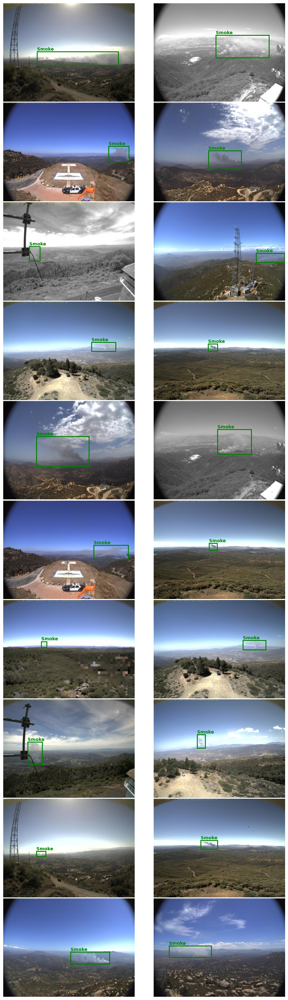

In [17]:
import matplotlib.pyplot as plt
import torchvision
from torchvision.transforms import functional as F

model.eval()
images_to_show = []
labels_to_show = []
boxes_to_show = []

confidence_threshold = 0.5
with torch.no_grad():
    for images, targets in test_loader:
        images = [img.to(device) for img in images]
        outputs = model(images)
        for img, output in zip(images, outputs):
            img_np = F.to_pil_image(img.cpu())
            boxes = output['boxes'][output['scores'] > confidence_threshold]
            labels = output['labels'][output['scores'] > confidence_threshold]
            images_to_show.append(img_np)
            boxes_to_show.append(boxes)
            labels_to_show.append(labels)
            if len(images_to_show) >= 20:
                break
        if len(images_to_show) >= 20:
            break

fig, axes = plt.subplots(10, 2, figsize=(12, 40))
plt.subplots_adjust(wspace=0.01, hspace=0.01)

for idx, ax in enumerate(axes.flatten()):
    img = images_to_show[idx]
    ax.imshow(img)
    for box, label in zip(boxes_to_show[idx], labels_to_show[idx]):
        x1, y1, x2, y2 = box.int().cpu().numpy()
        ax.add_patch(plt.Rectangle((x1, y1), x2-x1, y2-y1, fill=False, edgecolor='green', linewidth=2))
        ax.text(x1, max(y1-5,0), "Smoke", color='green', fontsize=10, weight='bold')
    ax.axis('off')

plt.show()


In [18]:
def predict_on_video_maskrcnn(model, input_video, raw_output, device, conf_threshold=0.5):
    model.eval()
    cap = cv2.VideoCapture(input_video)
    width  = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps    = cap.get(cv2.CAP_PROP_FPS)

    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(raw_output, fourcc, fps, (width, height))

    while True:
        ret, frame = cap.read()
        if not ret:
            break
        
        img = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        img_tensor = torch.from_numpy(img / 255.).permute(2,0,1).unsqueeze(0).float().to(device)
        pred = model([img_tensor[0]])[0]

        boxes = pred['boxes'].detach().cpu().numpy()
        scores = pred['scores'].detach().cpu().numpy()
        labels = pred['labels'].detach().cpu().numpy()
        
        for box, score, label in zip(boxes, scores, labels):
            if score > conf_threshold:
                x_min, y_min, x_max, y_max = map(int, box)
                cv2.rectangle(frame, (x_min, y_min), (x_max, y_max), (0,255,0), 3)
                cv2.putText(frame, f"Smoke: {score:.2f}", (x_min, max(y_min-10,0)),
                            cv2.FONT_HERSHEY_SIMPLEX, 4, (0,255,0), 4)

        out.write(frame)
    
    cap.release()
    out.release()


In [19]:
input_video = "/kaggle/input/custom-image-dataset/smoke.mp4"
raw_output = "/kaggle/working/video_maskrcnn_raw.mp4"

predict_on_video_maskrcnn(model, input_video, raw_output, device)


In [20]:
import subprocess

compressed_output = "/kaggle/working/video_maskrcnn_final.mp4"
subprocess.run(["ffmpeg", "-y", "-i", raw_output,"-c:v", "libx264", "-preset", "fast", "-crf", "23", compressed_output], check=True)


ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

CompletedProcess(args=['ffmpeg', '-y', '-i', '/kaggle/working/video_maskrcnn_raw.mp4', '-c:v', 'libx264', '-preset', 'fast', '-crf', '23', '/kaggle/working/video_maskrcnn_final.mp4'], returncode=0)

In [21]:
from base64 import b64encode
from IPython.display import HTML, display

with open(compressed_output, "rb") as f:
    video_data = f.read()

data_url = "data:video/mp4;base64," + b64encode(video_data).decode()
display(HTML(f'<video width="1000" height="500" controls><source src="{data_url}" type="video/mp4"></video>'))
